In [8]:
import pandas as pd
import snowflake.connector
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

In [ ]:
ctx = snowflake.connector.connect(
    user='USERNAME',
    password='PASS',
    account='ACC',
)

In [15]:
# Data of covid deaths during 2020 summer
# SQL query
query = '''
SELECT * FROM COVID19_EPIDEMIOLOGICAL_DATA.PUBLIC.JHU_COVID_19 where case_type = 'Deaths' and DATE 
between '2020-06-01' and '2020-08-31' 
order by DATE;
'''
#ctx stands for snowflake creds
# Execute the query and fetch the result into a Pandas DataFrame
result = ctx.cursor().execute(query)
df = pd.DataFrame(result.fetchall(), columns=[col[0] if isinstance(col, tuple) else col for col in result.description])

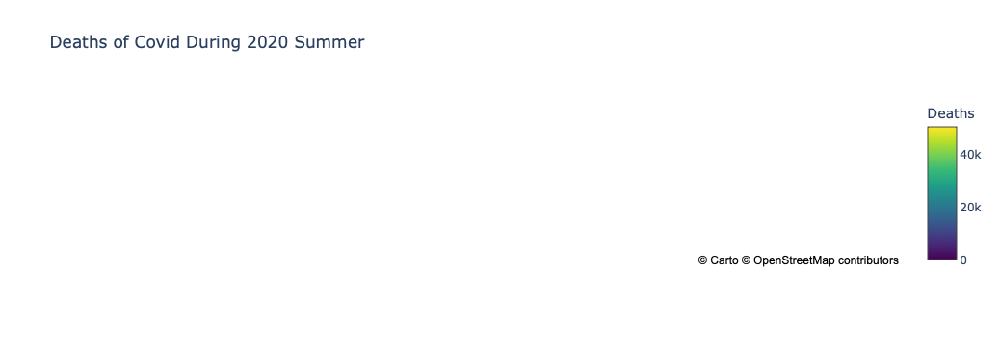

In [16]:
# a geographic heat map
fig = go.Figure(go.Densitymapbox(
    lat=df['LAT'],
    lon=df['LONG'],
    z=df['CASES'],
    radius=10,
    colorscale='Viridis',
    colorbar=dict(title='Deaths'),
))

# Updating the layout to include a mapbox
fig.update_layout(
    mapbox_style="carto-positron",
    mapbox_center_lon=0,
    mapbox_center_lat=0,
    mapbox_zoom=1,
)

fig.update_layout(title='Deaths of Covid During 2020 Summer')


fig.show()

In [17]:
# SQL query for summer 2020 deaths and total cases by continent
query = '''
SELECT * FROM COVID19_EPIDEMIOLOGICAL_DATA.PUBLIC.ECDC_GLOBAL  where DATE between '2020-06-01' and '2020-08-31';
'''

# Execute the query and fetch the result into a Pandas DataFrame
result = ctx.cursor().execute(query)
df = pd.DataFrame(result.fetchall(), columns=[col[0] if isinstance(col, tuple) else col for col in result.description])

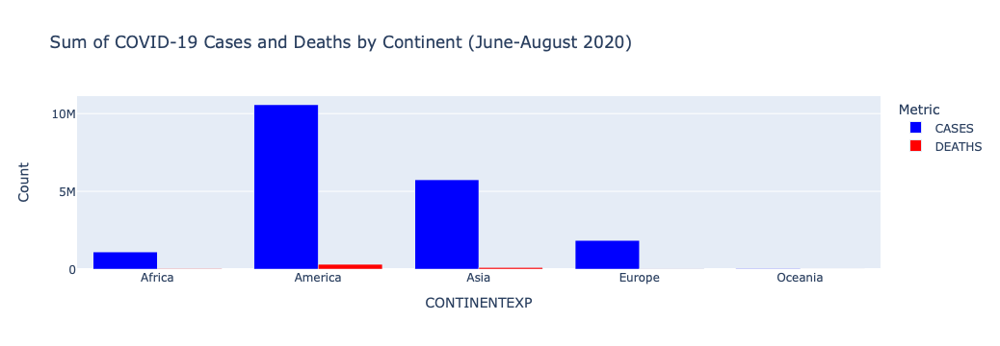

In [18]:
# Group by continent and sum up deaths and cases
df_sum = df.groupby('CONTINENTEXP').agg({'CASES': 'sum', 'DEATHS': 'sum'}).reset_index()

# Create a bar chart
fig = px.bar(df_sum, x='CONTINENTEXP', y=['CASES', 'DEATHS'],
             labels={'value': 'Count', 'variable': 'Metric'},
             title='Sum of COVID-19 Cases and Deaths by Continent (June-August 2020)',
             color_discrete_map={'CASES': 'blue', 'DEATHS': 'red'},
             barmode='group')

# Show the figure
fig.show()

In [19]:
# SQL query for vacciantion
query = '''
SELECT COUNTRY_REGION,COUNT(people_vaccinated) FROM COVID19_EPIDEMIOLOGICAL_DATA.PUBLIC.OWID_VACCINATIONS 
where people_vaccinated is not null group by COUNTRY_REGION;
'''

# Execute the query and fetch the result into a Pandas DataFrame
result = ctx.cursor().execute(query)
df = pd.DataFrame(result.fetchall(), columns=[col[0] if isinstance(col, tuple) else col for col in result.description])

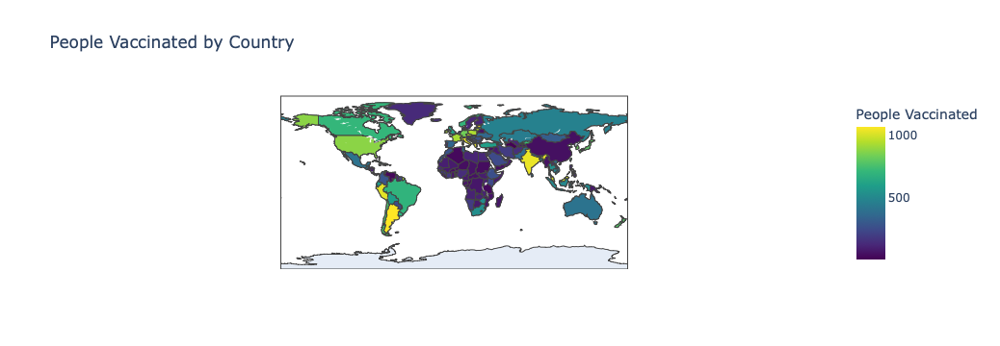

In [20]:
# Create a choropleth map
fig = px.choropleth(df,
                    locations='COUNTRY_REGION',
                    locationmode='country names',
                    color='COUNT(PEOPLE_VACCINATED)',
                    color_continuous_scale='Viridis',
                    title='People Vaccinated by Country',
                    labels={'COUNT(PEOPLE_VACCINATED)': 'People Vaccinated'},
                    hover_name='COUNTRY_REGION')

# Show the figure
fig.show()